In [2]:
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing import image
from keras.optimizers import RMSprop

Using TensorFlow backend.


In [3]:
!ls

Untitled.ipynb	test  train  validation


In [7]:
!ls test/kue_dadar_gulung

0.jpg  10.jpg  12.jpg  14.jpg  16.jpg  18.jpg  2.jpg  4.jpg  6.jpg  8.jpg
1.jpg  11.jpg  13.jpg  15.jpg  17.jpg  19.jpg  3.jpg  5.jpg  7.jpg  9.jpg


In [8]:
img = image.load_img("test/kue_dadar_gulung/0.jpg")

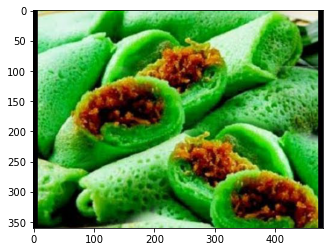

In [10]:
plt.imshow(img)

In [20]:
cv2.imread("test/kue_dadar_gulung/1.jpg").shape

(344, 460, 3)

In [90]:
train = ImageDataGenerator(rescale=1/255, 
                          rotation_range=40,
                          width_shift_range=0.2,
                          height_shift_range=0.2,
                          shear_range=0.2,
                          zoom_range=0.2,
                          horizontal_flip=True,
                          fill_mode='nearest',)

In [91]:
validation = ImageDataGenerator(rescale=1/255,
                          width_shift_range=0.2,
                          height_shift_range=0.2,
                          shear_range=0.2,
                          zoom_range=0.2,
                          horizontal_flip=True,
                          fill_mode='nearest',)

In [92]:
train_dataset = train.flow_from_directory('train/',
                                          target_size=(300,300), 
                                          batch_size = 3, 
                                          class_mode='categorical')

validation_dataset = train.flow_from_directory('validation/',
                                          target_size=(300,300), 
                                          batch_size = 3, 
                                          class_mode='categorical')

Found 1516 images belonging to 8 classes.
Found 160 images belonging to 8 classes.


In [93]:
train_dataset.class_indices

{'kue_dadar_gulung': 0,
 'kue_kastengel': 1,
 'kue_klepon': 2,
 'kue_lapis': 3,
 'kue_lumpur': 4,
 'kue_putri_salju': 5,
 'kue_risoles': 6,
 'kue_serabi': 7}

In [94]:
train_dataset.classes

array([0, 0, 0, ..., 7, 7, 7], dtype=int32)

In [95]:
from keras.models import Sequential
from keras.layers import Conv2D
from keras.layers import MaxPool2D, Flatten, Dense

In [96]:
model = Sequential([Conv2D(16, (3,3), activation = 'relu', input_shape=(300,300,3)), 
                    MaxPool2D(2,2), 
                    Conv2D(16, (3,3), activation = 'relu', input_shape=(300,300,3)),
                    MaxPool2D(2,2),
                    Conv2D(32, (3,3), activation = 'relu', input_shape=(300,300,3)),
                    MaxPool2D(2,2),
                    Flatten(),
                    Dense(512, activation='relu'),
                    Dense(8, activation='softmax')])

In [97]:
model.compile(loss='categorical_crossentropy',
             optimizer='adam',
             metrics=['accuracy'])

In [98]:
model_fit = model.fit(train_dataset,
                     epochs = 10,
                     validation_data= validation_dataset)

Epoch 1/10
506/506 [==============================] - 85s 165ms/step - loss: 2.0776 - accuracy: 0.2531 - val_loss: 1.6445 - val_accuracy: 0.3063
Epoch 2/10
506/506 [==============================] - 84s 166ms/step - loss: 1.6825 - accuracy: 0.3236 - val_loss: 1.6857 - val_accuracy: 0.2937
Epoch 3/10
506/506 [==============================] - 86s 169ms/step - loss: 1.6315 - accuracy: 0.3501 - val_loss: 1.4374 - val_accuracy: 0.5125
Epoch 4/10
506/506 [==============================] - 85s 168ms/step - loss: 1.5575 - accuracy: 0.3886 - val_loss: 1.4443 - val_accuracy: 0.4375
Epoch 5/10
506/506 [==============================] - 86s 170ms/step - loss: 1.5588 - accuracy: 0.3925 - val_loss: 1.6063 - val_accuracy: 0.3875
Epoch 6/10
506/506 [==============================] - 85s 167ms/step - loss: 1.4619 - accuracy: 0.4380 - val_loss: 1.4251 - val_accuracy: 0.4000
Epoch 7/10
506/506 [==============================] - 85s 168ms/step - loss: 1.4270 - accuracy: 0.4802 - val_loss: 1.3542 - val_ac

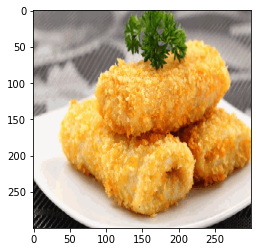

risoles


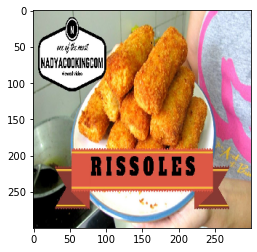

risoles


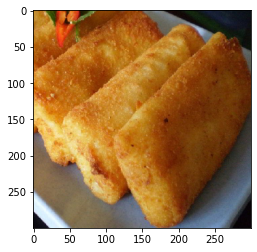

risoles


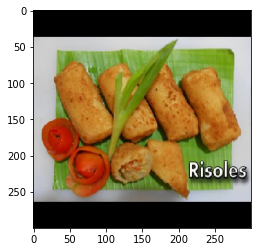

risoles


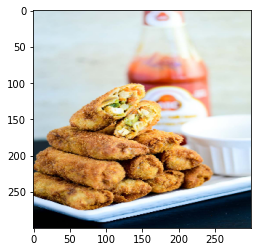

risoles


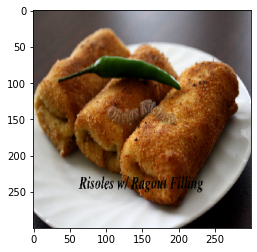

risoles


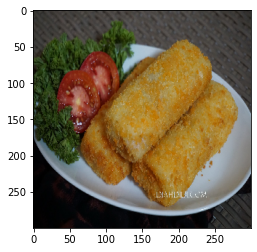

risoles


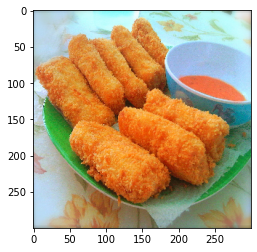

risoles


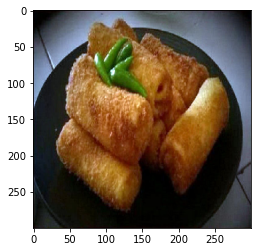

risoles


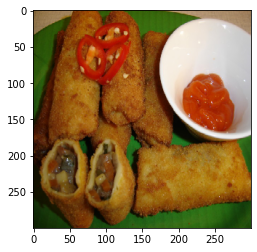

risoles


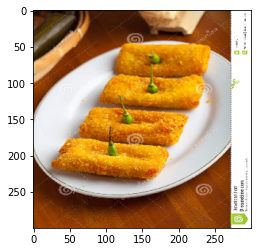

risoles


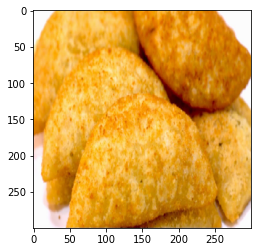

kasetengel


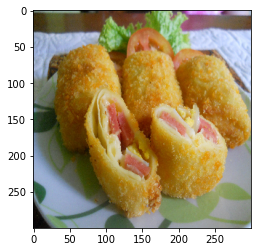

risoles


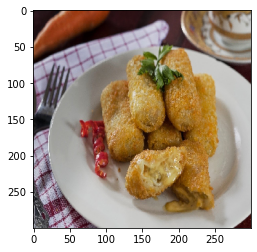

risoles


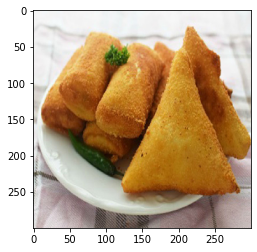

risoles


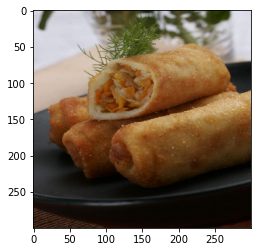

risoles


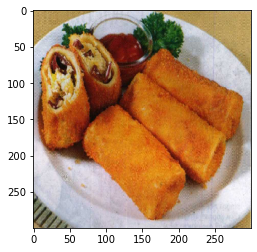

risoles


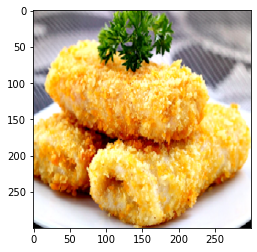

risoles


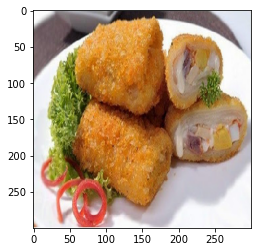

risoles


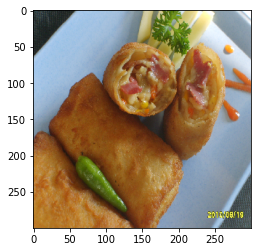

risoles


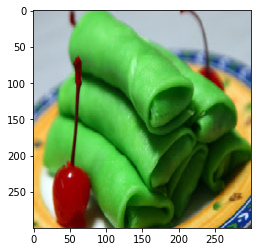

dadar gulung


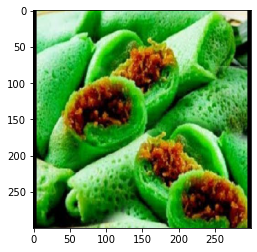

dadar gulung


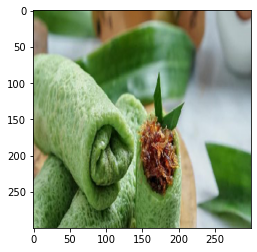

klepon


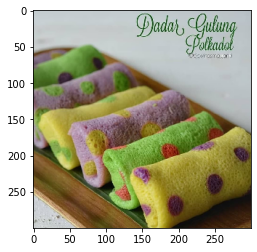

lumpur


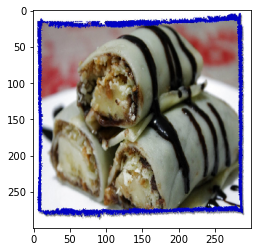

dadar gulung


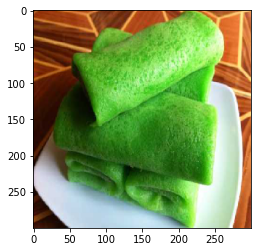

dadar gulung


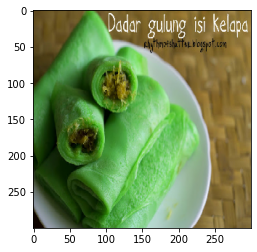

dadar gulung


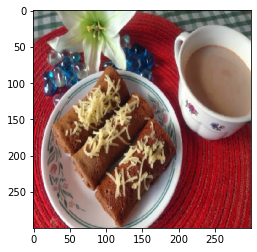

dadar gulung


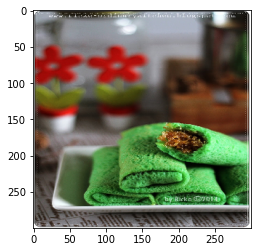

lapis


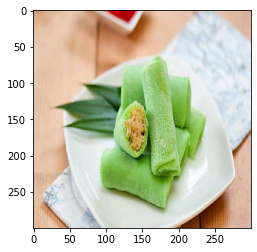

dadar gulung


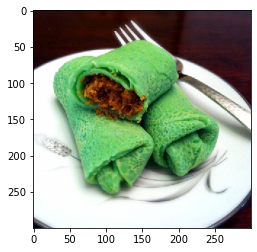

lapis


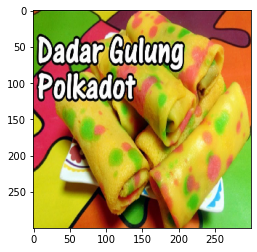

dadar gulung


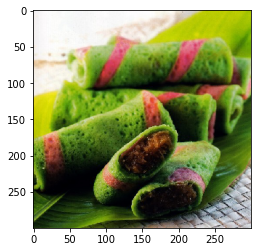

dadar gulung


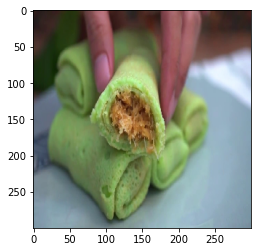

lapis


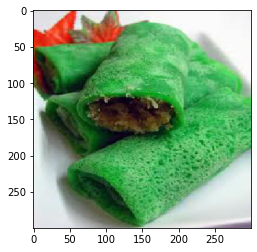

lapis


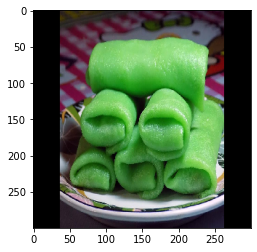

lapis


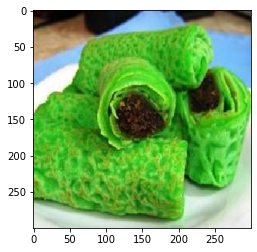

dadar gulung


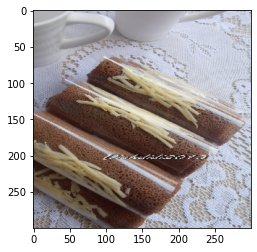

dadar gulung


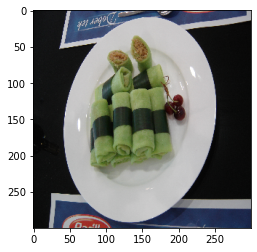

klepon


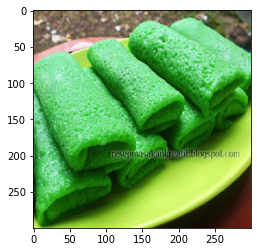

dadar gulung


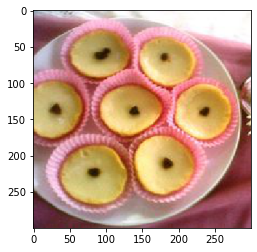

lapis


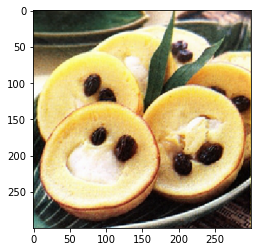

lumpur


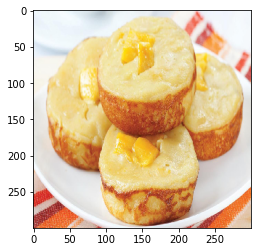

lumpur


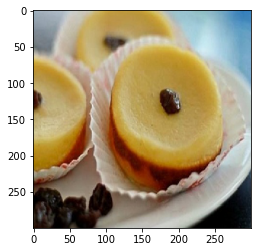

lumpur


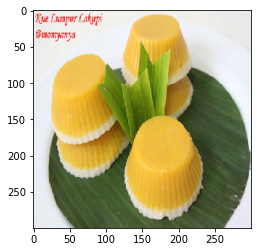

dadar gulung


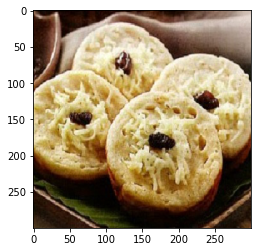

klepon


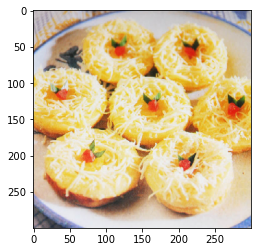

lumpur


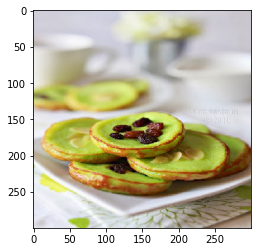

lumpur


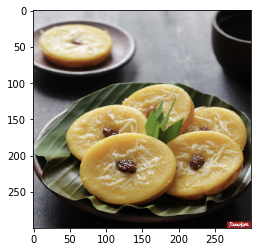

dadar gulung


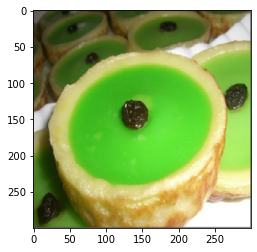

dadar gulung


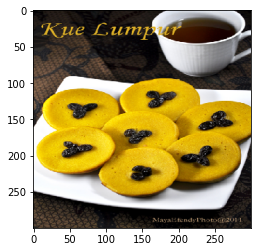

lumpur


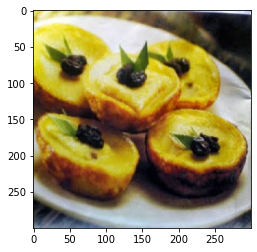

lumpur


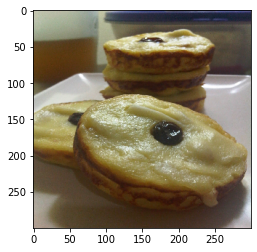

klepon


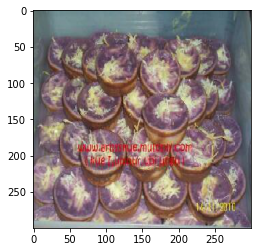

dadar gulung


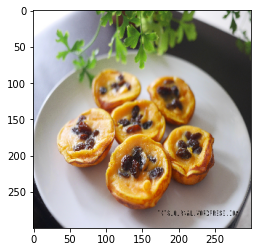

risoles


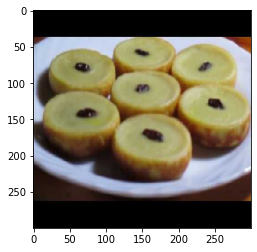

lumpur


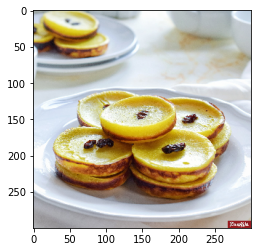

lumpur


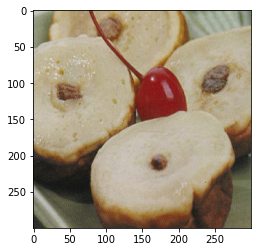

dadar gulung


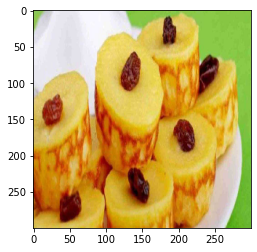

risoles


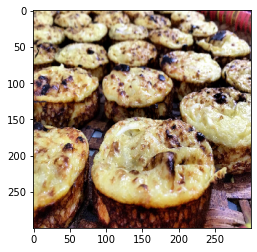

lumpur


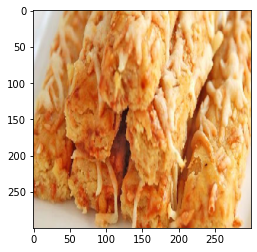

risoles


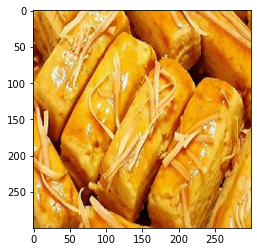

lumpur


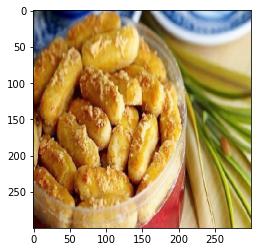

risoles


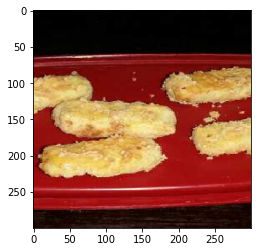

lumpur


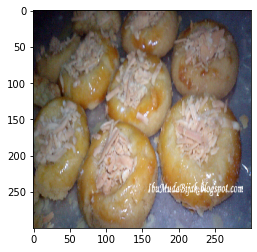

dadar gulung


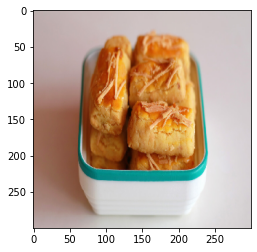

risoles


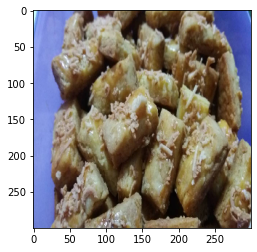

dadar gulung


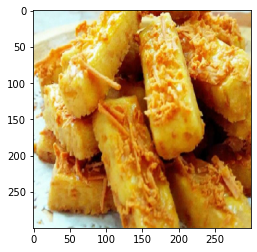

risoles


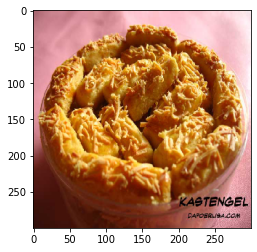

risoles


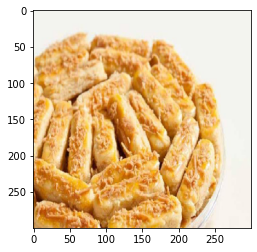

risoles


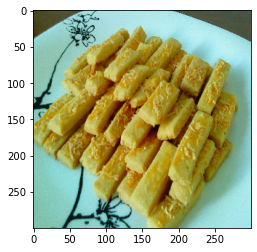

lapis


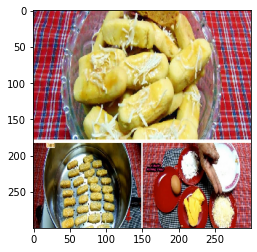

dadar gulung


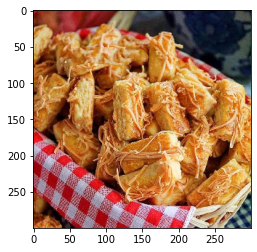

risoles


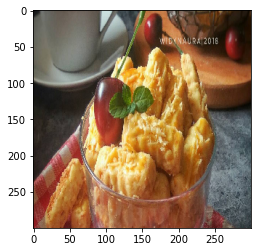

risoles


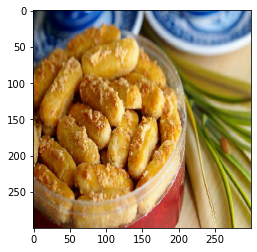

risoles


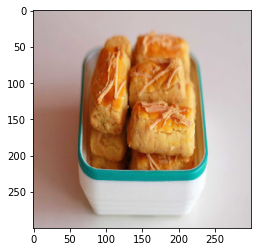

risoles


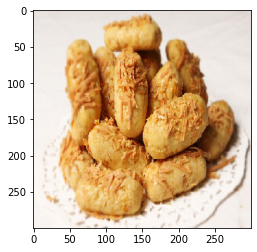

risoles


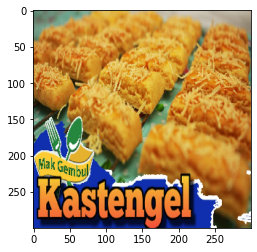

lumpur


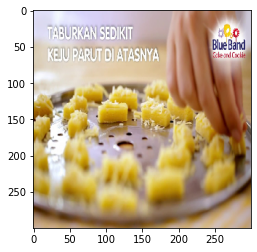

dadar gulung


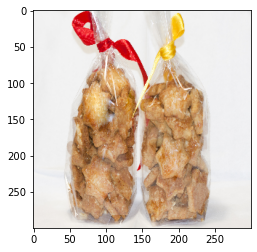

risoles


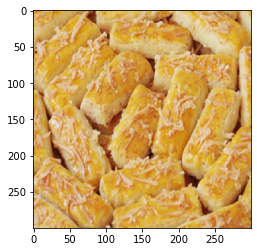

risoles


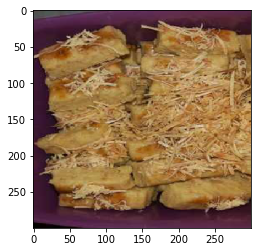

risoles


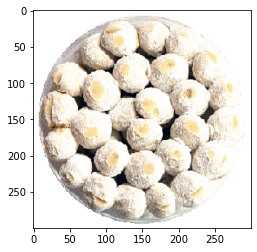

klepon


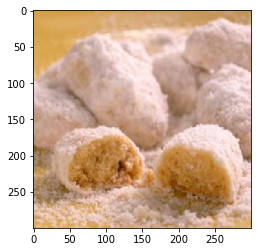

risoles


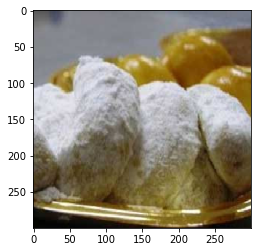

klepon


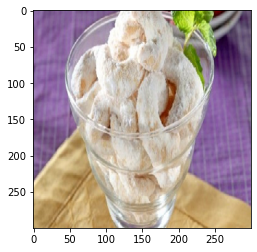

klepon


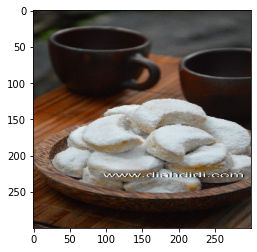

serabi


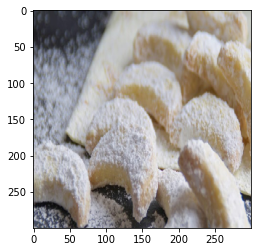

klepon


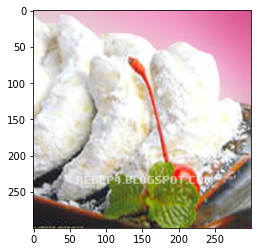

dadar gulung


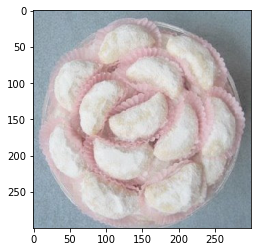

dadar gulung


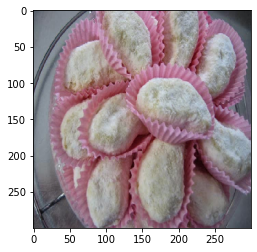

lapis


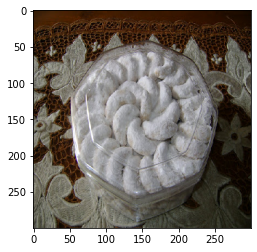

klepon


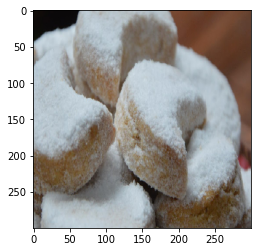

klepon


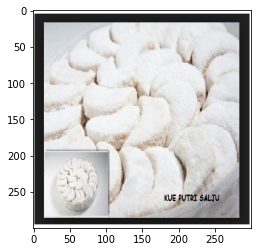

klepon


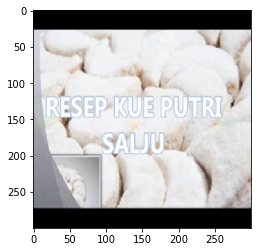

klepon


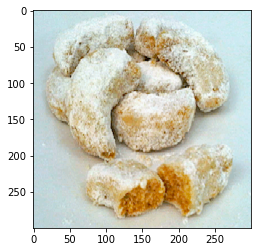

klepon


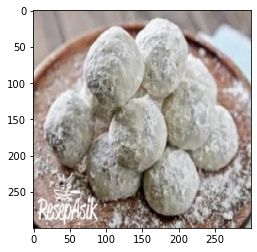

klepon


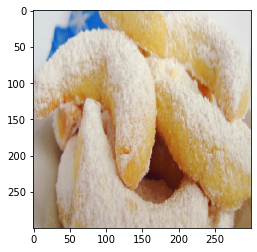

dadar gulung


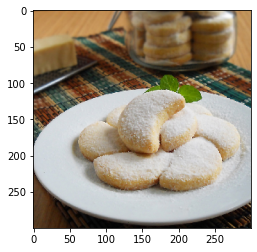

dadar gulung


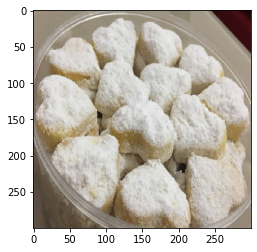

klepon


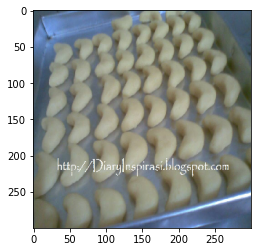

klepon


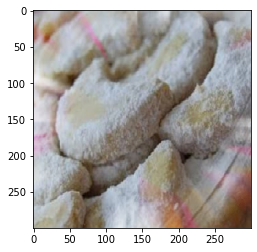

klepon


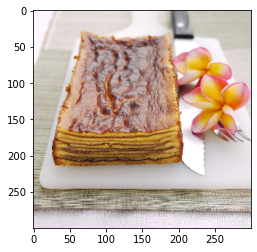

risoles


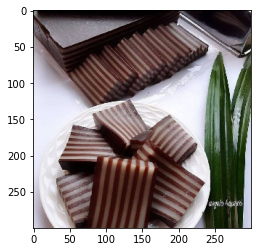

dadar gulung


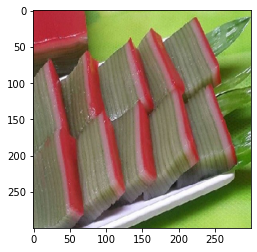

lapis


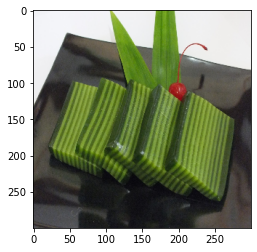

lapis


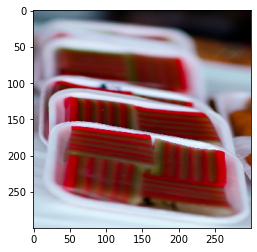

lapis


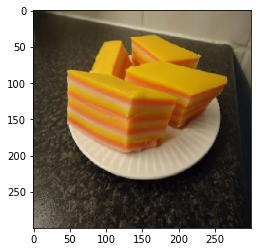

risoles


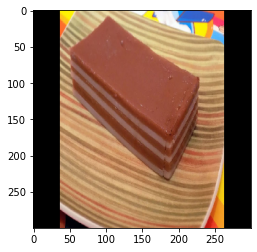

risoles


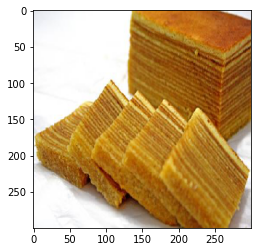

risoles


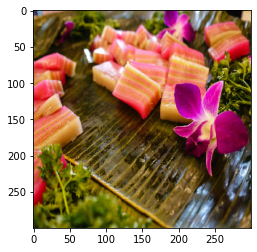

lapis


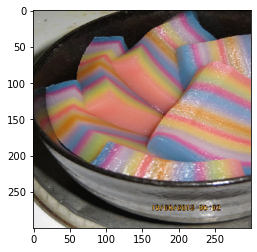

lapis


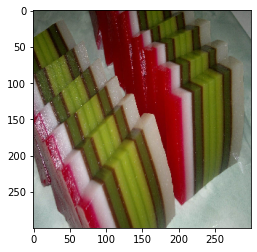

dadar gulung


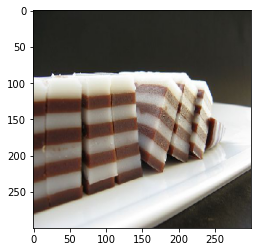

dadar gulung


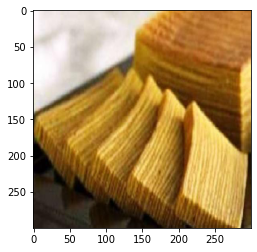

risoles


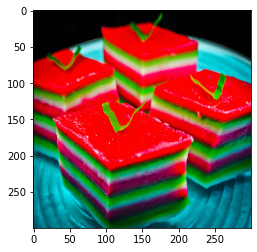

lapis


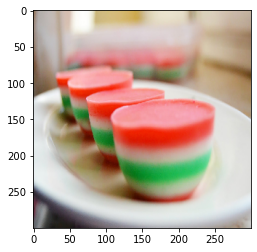

lapis


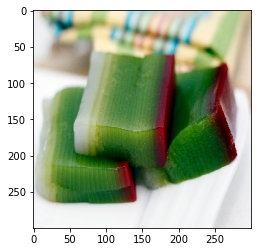

lapis


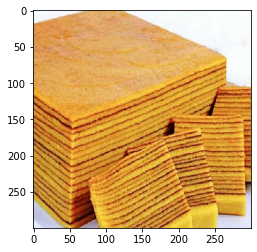

risoles


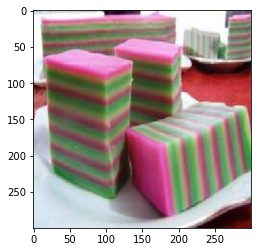

lapis


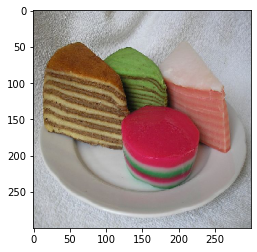

lapis


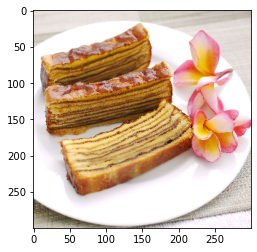

risoles


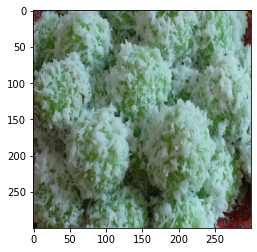

klepon


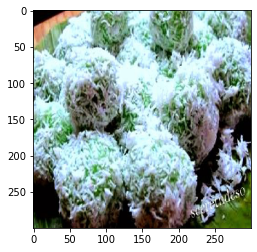

klepon


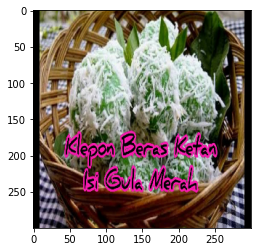

klepon


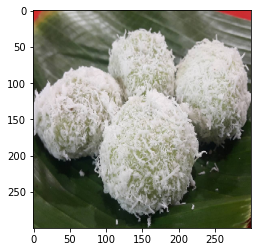

klepon


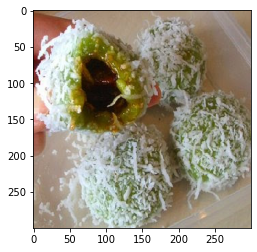

klepon


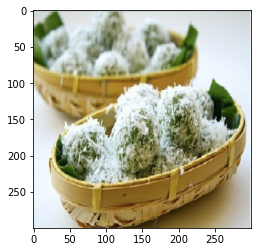

klepon


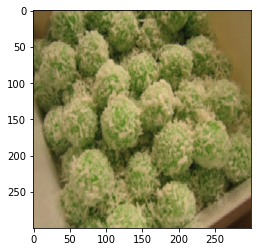

klepon


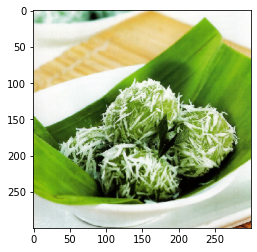

klepon


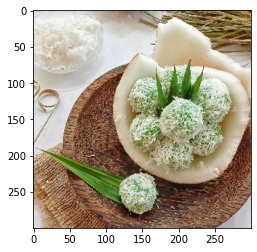

klepon


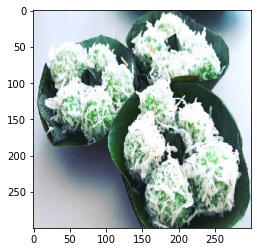

klepon


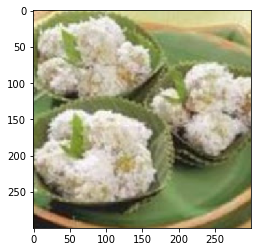

klepon


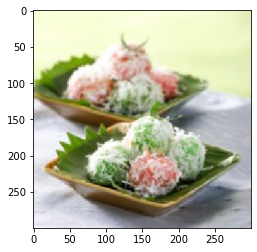

klepon


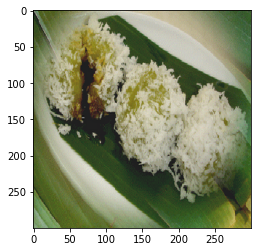

klepon


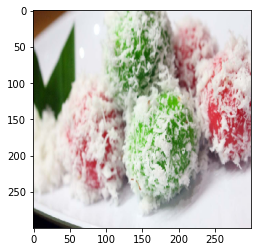

klepon


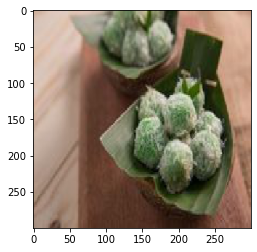

klepon


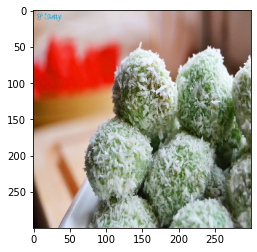

klepon


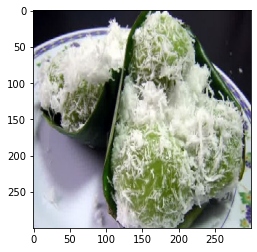

klepon


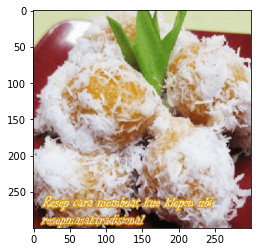

dadar gulung


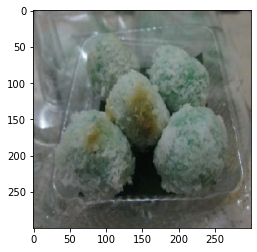

klepon


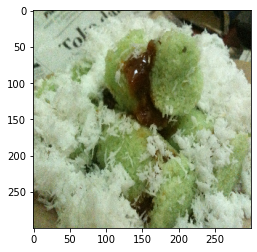

klepon


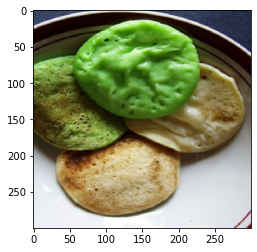

lumpur


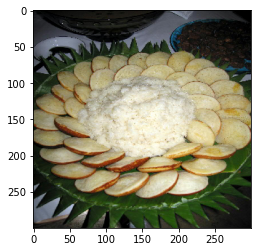

lumpur


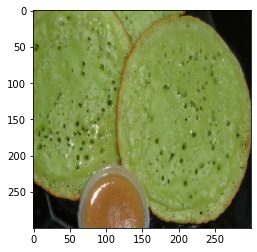

klepon


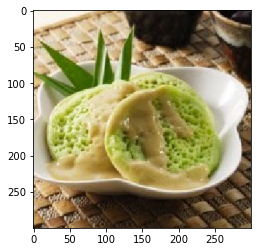

klepon


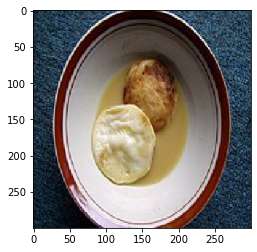

lapis


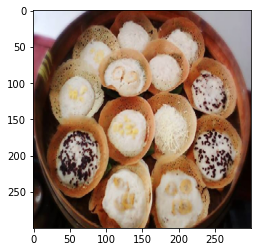

risoles


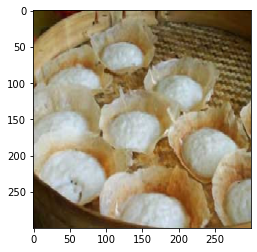

dadar gulung


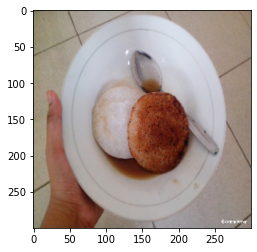

lapis


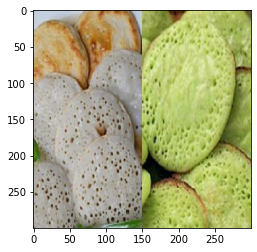

klepon


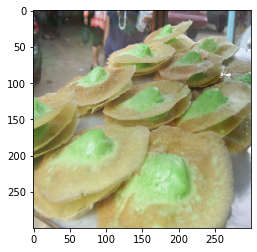

lapis


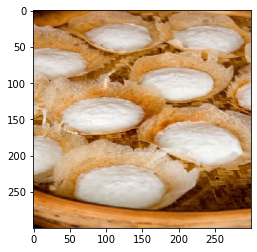

risoles


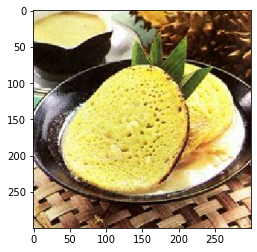

lumpur


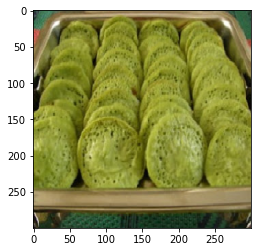

dadar gulung


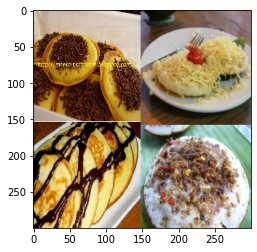

risoles


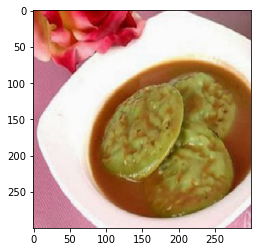

lapis


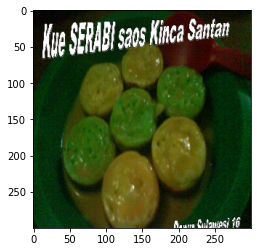

dadar gulung


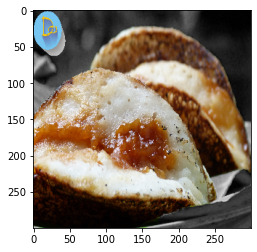

risoles


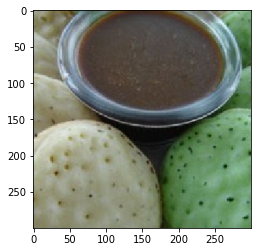

klepon


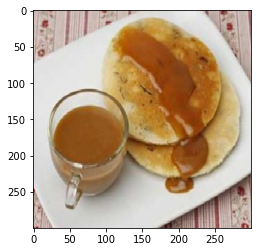

risoles


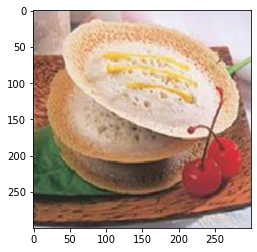

klepon


In [99]:
dir_path = 'test'
kueh = ["dadar gulung", "kasetengel", "klepon", "lapis", "lumpur", "putri salju", "risoles", "serabi"]

for i in os.listdir(dir_path):
    for j in os.listdir(dir_path+'//'+i):
        img = image.load_img(dir_path+'//'+i+'//'+j, target_size=(300,300))
        plt.imshow(img)
        plt.show()
        
        X = image.img_to_array(img)
        X = np.expand_dims(X, axis=0)
        images = np.vstack([X])
        val = model.predict([images]).astype(int)
        print(kueh[val[0].argmax()])
          